In [81]:
#libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import pandas_profiling

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import OneHotEncoder,RobustScaler

from sklearn.model_selection import GridSearchCV # grid search cross validation
from sklearn.model_selection import RandomizedSearchCV # randomized search cross validation

from sklearn.neighbors import KNeighborsClassifier 
from sklearn.naive_bayes import GaussianNB 
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier 
from sklearn.ensemble import AdaBoostClassifier 
from sklearn.ensemble import BaggingClassifier

import warnings
warnings.filterwarnings("ignore")

In [82]:
%matplotlib inline

In [83]:
#import data

train = pd.read_csv('data/fraudTrain.csv')
test = pd.read_csv('data/fraudTest.csv')

In [84]:
#preview data
train.head()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0


In [85]:
#preview data
test.head()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,0,2020-06-21 12:14:25,2291163933867244,fraud_Kirlin and Sons,personal_care,2.86,Jeff,Elliott,M,351 Darlene Green,...,33.9659,-80.9355,333497,Mechanical engineer,1968-03-19,2da90c7d74bd46a0caf3777415b3ebd3,1371816865,33.986391,-81.200714,0
1,1,2020-06-21 12:14:33,3573030041201292,fraud_Sporer-Keebler,personal_care,29.84,Joanne,Williams,F,3638 Marsh Union,...,40.3207,-110.4360,302,"Sales professional, IT",1990-01-17,324cc204407e99f51b0d6ca0055005e7,1371816873,39.450498,-109.960431,0
2,2,2020-06-21 12:14:53,3598215285024754,"fraud_Swaniawski, Nitzsche and Welch",health_fitness,41.28,Ashley,Lopez,F,9333 Valentine Point,...,40.6729,-73.5365,34496,"Librarian, public",1970-10-21,c81755dbbbea9d5c77f094348a7579be,1371816893,40.495810,-74.196111,0
3,3,2020-06-21 12:15:15,3591919803438423,fraud_Haley Group,misc_pos,60.05,Brian,Williams,M,32941 Krystal Mill Apt. 552,...,28.5697,-80.8191,54767,Set designer,1987-07-25,2159175b9efe66dc301f149d3d5abf8c,1371816915,28.812398,-80.883061,0
4,4,2020-06-21 12:15:17,3526826139003047,fraud_Johnston-Casper,travel,3.19,Nathan,Massey,M,5783 Evan Roads Apt. 465,...,44.2529,-85.0170,1126,Furniture designer,1955-07-06,57ff021bd3f328f8738bb535c302a31b,1371816917,44.959148,-85.884734,0


In [86]:
#combine split datasets and drop unnamed:0 column

df = pd.concat([train,test],ignore_index=True)
df.drop('Unnamed: 0',axis=1,inplace=True)

In [87]:
df.shape

(1852394, 22)

In [88]:
#check data types
df.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 22 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   trans_date_trans_time  1852394 non-null  object 
 1   cc_num                 1852394 non-null  int64  
 2   merchant               1852394 non-null  object 
 3   category               1852394 non-null  object 
 4   amt                    1852394 non-null  float64
 5   first                  1852394 non-null  object 
 6   last                   1852394 non-null  object 
 7   gender                 1852394 non-null  object 
 8   street                 1852394 non-null  object 
 9   city                   1852394 non-null  object 
 10  state                  1852394 non-null  object 
 11  zip                    1852394 non-null  int64  
 12  lat                    1852394 non-null  float64
 13  long                   1852394 non-null  float64
 14  city_pop          

In [89]:
#check null values
df.isnull().sum()

trans_date_trans_time    0
cc_num                   0
merchant                 0
category                 0
amt                      0
first                    0
last                     0
gender                   0
street                   0
city                     0
state                    0
zip                      0
lat                      0
long                     0
city_pop                 0
job                      0
dob                      0
trans_num                0
unix_time                0
merch_lat                0
merch_long               0
is_fraud                 0
dtype: int64

In [90]:
#Pandas Profile Report Start
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data Transform

#### CC Num

In [91]:
df.cc_num.value_counts()

6538441737335434       4392
30270432095985         4392
6538891242532018       4386
4364010865167176       4386
4642255475285942       4386
                       ... 
4714017207228610634       7
4352307151555405069       7
180097223252063           7
6011732631674654          7
4295296907373             6
Name: cc_num, Length: 999, dtype: int64

In [92]:
#extract CC bin to replace cc_num
df['cc_bin'] = df['cc_num'].astype(str).str[:6]

In [93]:
df.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,...,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,cc_bin
0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,Moravian Falls,...,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,270318
1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,Orient,...,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,630423
2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,Malad City,...,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,388594
3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,Boulder,...,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,353409
4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,Doe Hill,...,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,375534


In [94]:
#convert cc_bin to numeric
df["cc_bin"] = pd.to_numeric(df["cc_bin"])

In [95]:
#drop cc_num column
df.drop(columns=['cc_num'])

,trans_date_trans_time,merchant,category,amt,first,last,gender,street,city,state,...,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,cc_bin
0,2019-01-01 00:00:18,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,Moravian Falls,NC,...,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,270318
1,2019-01-01 00:00:44,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,Orient,WA,...,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,630423
2,2019-01-01 00:00:51,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,Malad City,ID,...,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,388594
3,2019-01-01 00:01:16,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,Boulder,MT,...,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,353409
4,2019-01-01 00:03:06,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,Doe Hill,VA,...,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,375534
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1852389,2020-12-31 23:59:07,fraud_Reilly and Sons,health_fitness,43.77,Michael,Olson,M,558 Michael Estates,Luray,MO,...,-91.8912,519,Town planner,1966-02-13,9b1f753c79894c9f4b71f04581835ada,1388534347,39.946837,-91.333331,0,305606
1852390,2020-12-31 23:59:09,fraud_Hoppe-Parisian,kids_pets,111.84,Jose,Vasquez,M,572 Davis Mountains,Lake Jackson,TX,...,-95.4401,28739,Futures trader,1999-12-27,2090647dac2c89a1d86c514c427f5b91,1388534349,29.661049,-96.186633,0,355661
1852391,2020-12-31 23:59:15,fraud_Rau-Robel,kids_pets,86.88,Ann,Lawson,F,144 Evans Islands Apt. 683,Burbank,WA,...,-118.9017,3684,Musician,1981-11-29,6c5b7c8add471975aa0fec023b2e8408,1388534355,46.658340,-119.715054,0,601172
1852392,2020-12-31 23:59:24,fraud_Breitenberg LLC,travel,7.99,Eric,Preston,M,7020 Doyle Stream Apt. 951,Mesa,ID,...,-116.4493,129,Cartographer,1965-12-15,14392d723bb7737606b2700ac791b7aa,1388534364,44.470525,-117.080888,0,407977


#### Merchant

In [96]:
#replace fraud_ from merchant column
df.merchant.value_counts()

fraud_Kilback LLC                        6262
fraud_Cormier LLC                        5246
fraud_Schumm PLC                         5195
fraud_Kuhn LLC                           5031
fraud_Boyer PLC                          4999
                                         ... 
fraud_Douglas, DuBuque and McKenzie      1101
fraud_Treutel-King                       1098
fraud_Satterfield-Lowe                   1095
fraud_Hahn, Douglas and Schowalter       1091
fraud_Ritchie, Bradtke and Stiedemann    1090
Name: merchant, Length: 693, dtype: int64

In [97]:
df['merchant'].replace(to_replace='fraud_',
                       value='',
                       inplace=True,
                       regex=True)

In [98]:
df.merchant.value_counts()

Kilback LLC                        6262
Cormier LLC                        5246
Schumm PLC                         5195
Kuhn LLC                           5031
Boyer PLC                          4999
                                   ... 
Douglas, DuBuque and McKenzie      1101
Treutel-King                       1098
Satterfield-Lowe                   1095
Hahn, Douglas and Schowalter       1091
Ritchie, Bradtke and Stiedemann    1090
Name: merchant, Length: 693, dtype: int64

In [99]:
#merchant will have high cardinality and may offer limited value to fraud prediction. Dropping column to help model performance
df = df.drop(columns=["merchant"])

#### Name,Gender, Job Columns

In [100]:
df['first'].value_counts()

Christopher    38112
Robert         30743
Jessica        29236
David          28564
Michael        28539
               ...  
Nicole             9
Phyllis            8
Molly              8
Angelica           7
Samantha           7
Name: first, Length: 355, dtype: int64

In [101]:
df['last'].value_counts()

Smith        40940
Williams     33661
Davis        31434
Johnson      28590
Rodriguez    24879
             ...  
Strong           8
Freeman          8
Schaefer         7
Bartlett         7
Blake            7
Name: last, Length: 486, dtype: int64

In [102]:
df['job'].value_counts()

Film/video editor             13898
Exhibition designer           13167
Surveyor, land/geomatics      12436
Naval architect               12434
Materials engineer            11711
                              ...  
Veterinary surgeon                8
Engineer, water                   8
Contracting civil engineer        7
Ship broker                       7
Warehouse manager                 7
Name: job, Length: 497, dtype: int64

In [103]:
df['gender'].value_counts()

F    1014749
M     837645
Name: gender, dtype: int64

In [104]:
#names are not very unique and since this is focused on fraud, the cardholder's name has limited relevance to the model. 
# Same thing with job and gender, that is not a quality feature to provide value.
#Dropping name,gender, and job columns
df = df.drop(columns=["first","last","job","gender"])

In [105]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 18 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   trans_date_trans_time  object 
 1   cc_num                 int64  
 2   category               object 
 3   amt                    float64
 4   street                 object 
 5   city                   object 
 6   state                  object 
 7   zip                    int64  
 8   lat                    float64
 9   long                   float64
 10  city_pop               int64  
 11  dob                    object 
 12  trans_num              object 
 13  unix_time              int64  
 14  merch_lat              float64
 15  merch_long             float64
 16  is_fraud               int64  
 17  cc_bin                 int64  
dtypes: float64(5), int64(6), object(7)
memory usage: 254.4+ MB


#### Unix Timestamp

In [106]:
#Unix timestamp can be used to create bins based how clustered the transactions
df["recentness"] = df.groupby(by="cc_num")["unix_time"].diff()

In [107]:
df.head()

,trans_date_trans_time,cc_num,category,amt,street,city,state,zip,lat,long,city_pop,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,cc_bin,recentness
0,2019-01-01 00:00:18,2703186189652095,misc_net,4.97,561 Perry Cove,Moravian Falls,NC,28654,36.0788,-81.1781,3495,1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,270318,NaN
1,2019-01-01 00:00:44,630423337322,grocery_pos,107.23,43039 Riley Greens Suite 393,Orient,WA,99160,48.8878,-118.2105,149,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,630423,NaN
2,2019-01-01 00:00:51,38859492057661,entertainment,220.11,594 White Dale Suite 530,Malad City,ID,83252,42.1808,-112.2620,4154,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,388594,NaN
3,2019-01-01 00:01:16,3534093764340240,gas_transport,45.00,9443 Cynthia Court Apt. 038,Boulder,MT,59632,46.2306,-112.1138,1939,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,353409,NaN
4,2019-01-01 00:03:06,375534208663984,misc_pos,41.96,408 Bradley Rest,Doe Hill,VA,24433,38.4207,-79.4629,99,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,375534,NaN


In [108]:
#make first value in group -1
df.loc[df.recentness.isnull(),["recentness"]] = -1

In [109]:
#convert seconds to minutes
df.recentness = df.recentness.apply(lambda x: float((x/60)/60))

In [110]:
#group recentness based on hours passed
df.loc[(df["recentness"]<1),["recentness_group"]] = "Less than 1 hour"
df.loc[((df["recentness"]>=1) & (df["recentness"]<6)),["recentness_group"]] = "Less than 6 hours"
df.loc[((df["recentness"]>=6) & (df["recentness"]<12)),["recentness_group"]] = "6-12 hours"
df.loc[((df["recentness"]>=12) & (df["recentness"]<24)),["recentness_group"]] = "12-24 hours"
df.loc[(df["recentness"]>=24),["recentness_group"]] = "More than 24 hours"
df.loc[(df["recentness"]<0),["recentness_group"]] = "First transaction"
df.recentness_group.value_counts(normalize = True)

Less than 6 hours     0.419903
6-12 hours            0.188907
Less than 1 hour      0.171562
12-24 hours           0.142412
More than 24 hours    0.076676
First transaction     0.000539
Name: recentness_group, dtype: float64

In [111]:
#drop recentness and unix time column
df = df.drop(columns=['recentness','unix_time'])

In [112]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 18 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   trans_date_trans_time  object 
 1   cc_num                 int64  
 2   category               object 
 3   amt                    float64
 4   street                 object 
 5   city                   object 
 6   state                  object 
 7   zip                    int64  
 8   lat                    float64
 9   long                   float64
 10  city_pop               int64  
 11  dob                    object 
 12  trans_num              object 
 13  merch_lat              float64
 14  merch_long             float64
 15  is_fraud               int64  
 16  cc_bin                 int64  
 17  recentness_group       object 
dtypes: float64(5), int64(5), object(8)
memory usage: 254.4+ MB


#### Transaction Date Time

In [113]:
#Extract time from trans_date_trans_time since that could be important for fraud
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], errors='coerce')

In [114]:
df['Transaction_Date'] = (df['trans_date_trans_time']).dt.date.astype('datetime64[ns]')

In [115]:
df['weekday_no'] = df['trans_date_trans_time'].dt.dayofweek
df['week_no'] = df['trans_date_trans_time'].dt.week
df['day_no'] = df['trans_date_trans_time'].dt.day
df['min_day'] = df['trans_date_trans_time'].dt.minute
df['hr_day'] = df['trans_date_trans_time'].dt.hour
df['month'] = df['trans_date_trans_time'].dt.month
df['year'] = df['trans_date_trans_time'].dt.year

In [116]:
df.head(5)

,trans_date_trans_time,cc_num,category,amt,street,city,state,zip,lat,long,...,cc_bin,recentness_group,Transaction_Date,weekday_no,week_no,day_no,min_day,hr_day,month,year
0,2019-01-01 00:00:18,2703186189652095,misc_net,4.97,561 Perry Cove,Moravian Falls,NC,28654,36.0788,-81.1781,...,270318,First transaction,2019-01-01,1,1,1,0,0,1,2019
1,2019-01-01 00:00:44,630423337322,grocery_pos,107.23,43039 Riley Greens Suite 393,Orient,WA,99160,48.8878,-118.2105,...,630423,First transaction,2019-01-01,1,1,1,0,0,1,2019
2,2019-01-01 00:00:51,38859492057661,entertainment,220.11,594 White Dale Suite 530,Malad City,ID,83252,42.1808,-112.2620,...,388594,First transaction,2019-01-01,1,1,1,0,0,1,2019
3,2019-01-01 00:01:16,3534093764340240,gas_transport,45.00,9443 Cynthia Court Apt. 038,Boulder,MT,59632,46.2306,-112.1138,...,353409,First transaction,2019-01-01,1,1,1,1,0,1,2019
4,2019-01-01 00:03:06,375534208663984,misc_pos,41.96,408 Bradley Rest,Doe Hill,VA,24433,38.4207,-79.4629,...,375534,First transaction,2019-01-01,1,1,1,3,0,1,2019


In [117]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 26 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   trans_date_trans_time  datetime64[ns]
 1   cc_num                 int64         
 2   category               object        
 3   amt                    float64       
 4   street                 object        
 5   city                   object        
 6   state                  object        
 7   zip                    int64         
 8   lat                    float64       
 9   long                   float64       
 10  city_pop               int64         
 11  dob                    object        
 12  trans_num              object        
 13  merch_lat              float64       
 14  merch_long             float64       
 15  is_fraud               int64         
 16  cc_bin                 int64         
 17  recentness_group       object        
 18  Transaction_Date      

In [118]:
#drop redundant trans_date_trans_time column
df = df.drop(columns=['trans_date_trans_time'])

#### Lat/Long Evaluation

In [119]:
#Haversine formula for lat/long converstion to distance
def haversine_np(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)

    All args must be of equal length.    

    """
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    
    ''' Feed longitude first and latitude second'''

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    km = 6371 * c  #6367
    return km

In [120]:
df['distance_cardholder_to_merchant_kms'] = haversine_np(df['long'],df['lat'],df['merch_long'],df['merch_lat'])

In [121]:
df.head()

,cc_num,category,amt,street,city,state,zip,lat,long,city_pop,...,recentness_group,Transaction_Date,weekday_no,week_no,day_no,min_day,hr_day,month,year,distance_cardholder_to_merchant_kms
0,2703186189652095,misc_net,4.97,561 Perry Cove,Moravian Falls,NC,28654,36.0788,-81.1781,3495,...,First transaction,2019-01-01,1,1,1,0,0,1,2019,78.597568
1,630423337322,grocery_pos,107.23,43039 Riley Greens Suite 393,Orient,WA,99160,48.8878,-118.2105,149,...,First transaction,2019-01-01,1,1,1,0,0,1,2019,30.212176
2,38859492057661,entertainment,220.11,594 White Dale Suite 530,Malad City,ID,83252,42.1808,-112.2620,4154,...,First transaction,2019-01-01,1,1,1,0,0,1,2019,108.206083
3,3534093764340240,gas_transport,45.00,9443 Cynthia Court Apt. 038,Boulder,MT,59632,46.2306,-112.1138,1939,...,First transaction,2019-01-01,1,1,1,1,0,1,2019,95.673231
4,375534208663984,misc_pos,41.96,408 Bradley Rest,Doe Hill,VA,24433,38.4207,-79.4629,99,...,First transaction,2019-01-01,1,1,1,3,0,1,2019,77.556744


In [122]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 26 columns):
 #   Column                               Dtype         
---  ------                               -----         
 0   cc_num                               int64         
 1   category                             object        
 2   amt                                  float64       
 3   street                               object        
 4   city                                 object        
 5   state                                object        
 6   zip                                  int64         
 7   lat                                  float64       
 8   long                                 float64       
 9   city_pop                             int64         
 10  dob                                  object        
 11  trans_num                            object        
 12  merch_lat                            float64       
 13  merch_long                 

In [123]:
#drop redundant columns
df = df.drop(columns=['lat','long','merch_lat','merch_long'])

In [124]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 22 columns):
 #   Column                               Dtype         
---  ------                               -----         
 0   cc_num                               int64         
 1   category                             object        
 2   amt                                  float64       
 3   street                               object        
 4   city                                 object        
 5   state                                object        
 6   zip                                  int64         
 7   city_pop                             int64         
 8   dob                                  object        
 9   trans_num                            object        
 10  is_fraud                             int64         
 11  cc_bin                               int64         
 12  recentness_group                     object        
 13  Transaction_Date           

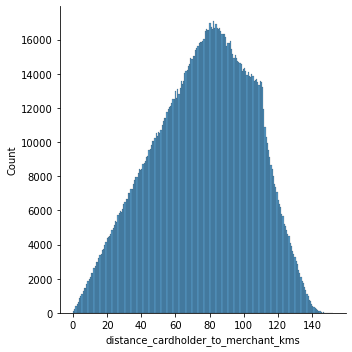

In [125]:
sns.displot(df, x="distance_cardholder_to_merchant_kms")
plt.show()

In [126]:
#create groups for distance
df.loc[(df["distance_cardholder_to_merchant_kms"]<30),["card_to_merch_kms"]] = "under 30"
df.loc[((df["distance_cardholder_to_merchant_kms"]>29) & (df["distance_cardholder_to_merchant_kms"]<61)),["card_to_merch_kms"]] = "30 to 60"
df.loc[((df["distance_cardholder_to_merchant_kms"]>59) & (df["distance_cardholder_to_merchant_kms"]<91)),["card_to_merch_kms"]] = "60 to 90"
df.loc[((df["distance_cardholder_to_merchant_kms"]>89) & (df["distance_cardholder_to_merchant_kms"]<121)),["card_to_merch_kms"]] = "90 to 120"
df.loc[(df["distance_cardholder_to_merchant_kms"]>119),["card_to_merch_kms"]] = "120 plus"

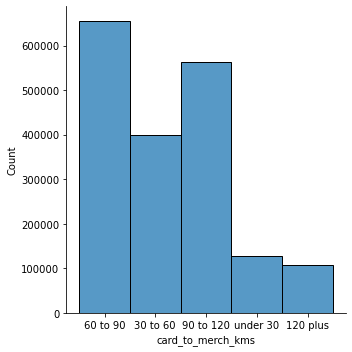

In [127]:
sns.displot(df, x="card_to_merch_kms")
plt.show()

In [128]:
#dropping distance_cardholder_to_merchant_kms
df = df.drop(columns=['distance_cardholder_to_merchant_kms'])

#### Address and City Population

In [129]:
#dropping cardholder's address line 1, city, and state as zip can account for clustered fraud
df = df.drop(columns=['street','city','state'])

In [130]:
#create groups of populations
df.loc[(df["city_pop"]<10000),["city_pop_cat"]] = "low density"
df.loc[((df["city_pop"]>10000) & (df["city_pop"]<50000)),["city_pop_cat"]] = "med density "
df.loc[(df["city_pop"]>50000),["city_pop_cat"]] = "high density"

In [131]:
df.head()

,cc_num,category,amt,zip,city_pop,dob,trans_num,is_fraud,cc_bin,recentness_group,Transaction_Date,weekday_no,week_no,day_no,min_day,hr_day,month,year,card_to_merch_kms,city_pop_cat
0,2703186189652095,misc_net,4.97,28654,3495,1988-03-09,0b242abb623afc578575680df30655b9,0,270318,First transaction,2019-01-01,1,1,1,0,0,1,2019,60 to 90,low density
1,630423337322,grocery_pos,107.23,99160,149,1978-06-21,1f76529f8574734946361c461b024d99,0,630423,First transaction,2019-01-01,1,1,1,0,0,1,2019,30 to 60,low density
2,38859492057661,entertainment,220.11,83252,4154,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,0,388594,First transaction,2019-01-01,1,1,1,0,0,1,2019,90 to 120,low density
3,3534093764340240,gas_transport,45.00,59632,1939,1967-01-12,6b849c168bdad6f867558c3793159a81,0,353409,First transaction,2019-01-01,1,1,1,1,0,1,2019,90 to 120,low density
4,375534208663984,misc_pos,41.96,24433,99,1986-03-28,a41d7549acf90789359a9aa5346dcb46,0,375534,First transaction,2019-01-01,1,1,1,3,0,1,2019,60 to 90,low density


In [132]:
#drop city_pop
df = df.drop(columns=['city_pop'])

In [133]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 19 columns):
 #   Column             Dtype         
---  ------             -----         
 0   cc_num             int64         
 1   category           object        
 2   amt                float64       
 3   zip                int64         
 4   dob                object        
 5   trans_num          object        
 6   is_fraud           int64         
 7   cc_bin             int64         
 8   recentness_group   object        
 9   Transaction_Date   datetime64[ns]
 10  weekday_no         int64         
 11  week_no            int64         
 12  day_no             int64         
 13  min_day            int64         
 14  hr_day             int64         
 15  month              int64         
 16  year               int64         
 17  card_to_merch_kms  object        
 18  city_pop_cat       object        
dtypes: datetime64[ns](1), float64(1), int64(11), object(6)
memory u

#### DOB to Age group

In [134]:
#convert dob to date time
df['dob'] = pd.to_datetime(df['dob'], errors='coerce')

In [135]:
#calc age
df['age'] = df['Transaction_Date'].dt.year - df['dob'].dt.year

In [136]:
df.head()

,cc_num,category,amt,zip,dob,trans_num,is_fraud,cc_bin,recentness_group,Transaction_Date,weekday_no,week_no,day_no,min_day,hr_day,month,year,card_to_merch_kms,city_pop_cat,age
0,2703186189652095,misc_net,4.97,28654,1988-03-09,0b242abb623afc578575680df30655b9,0,270318,First transaction,2019-01-01,1,1,1,0,0,1,2019,60 to 90,low density,31
1,630423337322,grocery_pos,107.23,99160,1978-06-21,1f76529f8574734946361c461b024d99,0,630423,First transaction,2019-01-01,1,1,1,0,0,1,2019,30 to 60,low density,41
2,38859492057661,entertainment,220.11,83252,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,0,388594,First transaction,2019-01-01,1,1,1,0,0,1,2019,90 to 120,low density,57
3,3534093764340240,gas_transport,45.00,59632,1967-01-12,6b849c168bdad6f867558c3793159a81,0,353409,First transaction,2019-01-01,1,1,1,1,0,1,2019,90 to 120,low density,52
4,375534208663984,misc_pos,41.96,24433,1986-03-28,a41d7549acf90789359a9aa5346dcb46,0,375534,First transaction,2019-01-01,1,1,1,3,0,1,2019,60 to 90,low density,33


In [137]:
#create groups for ages
df.loc[(df["age"]<30),["age_group"]] = "under 30"
df.loc[((df["age"]>29) & (df["age"]<41)),["age_group"]] = "30 to 40"
df.loc[((df["age"]>39) & (df["age"]<51)),["age_group"]] = "40 to 50"
df.loc[((df["age"]>49) & (df["age"]<61)),["age_group"]] = "50 to 60"
df.loc[((df["age"]>59) & (df["age"]<71)),["age_group"]] = "60 to 70"
df.loc[((df["age"]>69) & (df["age"]<81)),["age_group"]] = "70 to 80"
df.loc[(df["age"]>79),["age_group"]] = "80 plus"

In [138]:
df.head()

,cc_num,category,amt,zip,dob,trans_num,is_fraud,cc_bin,recentness_group,Transaction_Date,...,week_no,day_no,min_day,hr_day,month,year,card_to_merch_kms,city_pop_cat,age,age_group
0,2703186189652095,misc_net,4.97,28654,1988-03-09,0b242abb623afc578575680df30655b9,0,270318,First transaction,2019-01-01,...,1,1,0,0,1,2019,60 to 90,low density,31,30 to 40
1,630423337322,grocery_pos,107.23,99160,1978-06-21,1f76529f8574734946361c461b024d99,0,630423,First transaction,2019-01-01,...,1,1,0,0,1,2019,30 to 60,low density,41,40 to 50
2,38859492057661,entertainment,220.11,83252,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,0,388594,First transaction,2019-01-01,...,1,1,0,0,1,2019,90 to 120,low density,57,50 to 60
3,3534093764340240,gas_transport,45.00,59632,1967-01-12,6b849c168bdad6f867558c3793159a81,0,353409,First transaction,2019-01-01,...,1,1,1,0,1,2019,90 to 120,low density,52,50 to 60
4,375534208663984,misc_pos,41.96,24433,1986-03-28,a41d7549acf90789359a9aa5346dcb46,0,375534,First transaction,2019-01-01,...,1,1,3,0,1,2019,60 to 90,low density,33,30 to 40


In [139]:
#drop age, dob, and transaction_date since we are done with them
df = df.drop(columns=['age','dob','Transaction_Date'])

#### Final Cleanup

In [140]:
df = df.drop(columns=['trans_num','cc_num'])

In [141]:
#Finish pre-processing
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Address skewness

In [142]:
df.skew().sort_values(ascending=False)

amt           40.812809
is_fraud      13.745675
cc_bin         0.300106
zip            0.078950
weekday_no     0.007780
min_day       -0.000108
year          -0.002909
day_no        -0.003649
week_no       -0.122713
month         -0.130155
hr_day        -0.283419
dtype: float64

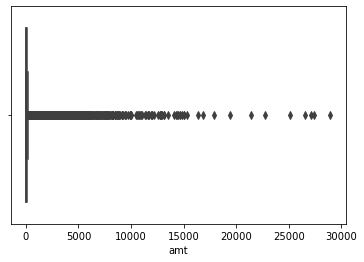

In [143]:
sns.boxplot(x=df["amt"])
plt.show()

In [144]:
#log transformation: transform skewed distribution to a normal distribution
df['amt'] = np.log(df['amt'])

In [145]:
df.skew().sort_values(ascending=False)

is_fraud      13.745675
cc_bin         0.300106
zip            0.078950
weekday_no     0.007780
min_day       -0.000108
year          -0.002909
day_no        -0.003649
week_no       -0.122713
month         -0.130155
hr_day        -0.283419
amt           -0.452045
dtype: float64

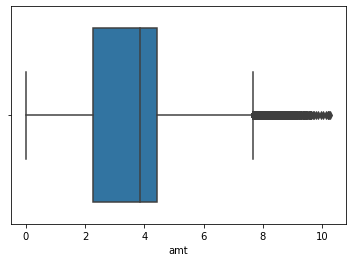

In [146]:
%matplotlib inline
sns.boxplot(x=df["amt"])
plt.show()

## Correlation

<AxesSubplot:>

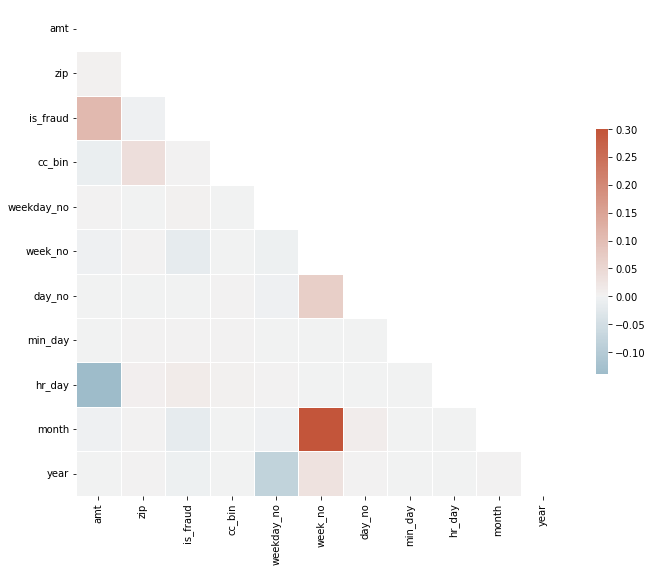

In [147]:
# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [148]:
corr_matrix = df.corr().abs()

# Upper part of matrix only
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# list highly correlated features
high_corr = [column for column in upper.columns if any(upper[column] > 0.75)]
high_corr

['month']

In [149]:
#drop highly correlated
df.drop(['month'],1,inplace=True)

In [150]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852394 entries, 0 to 1852393
Data columns (total 15 columns):
 #   Column             Dtype  
---  ------             -----  
 0   category           object 
 1   amt                float64
 2   zip                int64  
 3   is_fraud           int64  
 4   cc_bin             int64  
 5   recentness_group   object 
 6   weekday_no         int64  
 7   week_no            int64  
 8   day_no             int64  
 9   min_day            int64  
 10  hr_day             int64  
 11  year               int64  
 12  card_to_merch_kms  object 
 13  city_pop_cat       object 
 14  age_group          object 
dtypes: float64(1), int64(9), object(5)
memory usage: 212.0+ MB


In [151]:
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
<frozen importlib._bootstrap>:219: RuntimeWarning: scip

## Model Building

#### Train test split

In [69]:
X = df.drop(['is_fraud'],axis=1)
y = df['is_fraud']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

#### Encoding categorical variables

In [70]:
X_train = pd.get_dummies(data=X_train,columns=['category','recentness_group','card_to_merch_kms','city_pop_cat','age_group'], drop_first=True)

In [71]:
X_test = pd.get_dummies(data=X_test,columns=['category','recentness_group','card_to_merch_kms','city_pop_cat','age_group'], drop_first=True)

#### Scaling

In [72]:
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [73]:
X_train.shape

(1296675, 39)

In [74]:
y_train.shape

(1296675,)

#### SMOTE Resampling

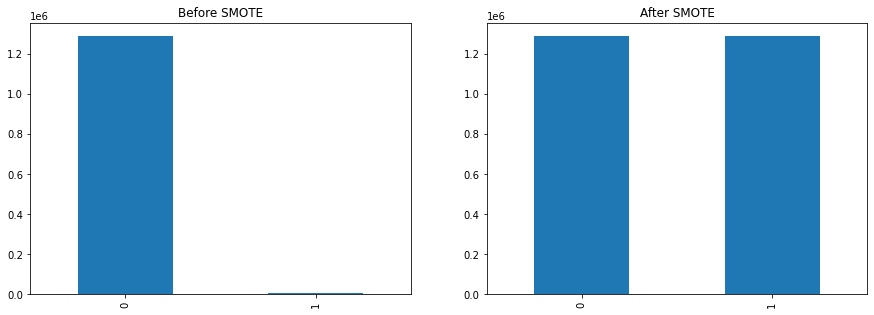

In [75]:
#check suspected imbalance with target variable
sm = SMOTE()
X_train_new, y_train_new = sm.fit_resample(X_train, y_train.ravel())

# graph differences
fig, (ax1, ax2) = plt.subplots(ncols = 2, figsize =(15, 5))
ax1.set_title('Before SMOTE')
pd.Series(y_train).value_counts().plot.bar(ax=ax1)

ax2.set_title('After SMOTE')  
pd.Series(y_train_new).value_counts().plot.bar(ax=ax2)

plt.show()

In [76]:
#proceed with SMOTE
X_train, y_train = sm.fit_resample(X_train, y_train.ravel())

#### Gaussian Naive Bayes

In [169]:
gnb = GaussianNB()
gnb.fit(X_train,y_train)
gnb_pred = gnb.predict(X_test)

print(confusion_matrix(y_test,gnb_pred))
print('\n')
print(classification_report(y_test,gnb_pred))

[[365068 187713]
 [   754   2184]]


              precision    recall  f1-score   support

           0       1.00      0.66      0.79    552781
           1       0.01      0.74      0.02      2938

    accuracy                           0.66    555719
   macro avg       0.50      0.70      0.41    555719
weighted avg       0.99      0.66      0.79    555719



#### Decision Tree

In [170]:
dtree = DecisionTreeClassifier()
dtree.fit(X_train,y_train)
dtree_pred = dtree.predict(X_test)

print(confusion_matrix(y_test,dtree_pred))
print('\n')
print(classification_report(y_test,dtree_pred))

[[551531   1250]
 [   624   2314]]


              precision    recall  f1-score   support

           0       1.00      1.00      1.00    552781
           1       0.65      0.79      0.71      2938

    accuracy                           1.00    555719
   macro avg       0.82      0.89      0.86    555719
weighted avg       1.00      1.00      1.00    555719



#### Random Forest

In [171]:
rfc = RandomForestClassifier(n_estimators=200)
rfc.fit(X_train,y_train)
rfc_pred = rfc.predict(X_test)

print(confusion_matrix(y_test,rfc_pred))
print('\n')
print(classification_report(y_test,rfc_pred))

[[552521    260]
 [   715   2223]]


              precision    recall  f1-score   support

           0       1.00      1.00      1.00    552781
           1       0.90      0.76      0.82      2938

    accuracy                           1.00    555719
   macro avg       0.95      0.88      0.91    555719
weighted avg       1.00      1.00      1.00    555719



#### AdaBoost

In [172]:
adabc = AdaBoostClassifier(DecisionTreeClassifier(max_depth=1),n_estimators=200)
adabc.fit(X_train,y_train)
adabc_pred = adabc.predict(X_test)

print(confusion_matrix(y_test,adabc_pred))
print('\n')
print(classification_report(y_test,adabc_pred))

[[546007   6774]
 [   589   2349]]


              precision    recall  f1-score   support

           0       1.00      0.99      0.99    552781
           1       0.26      0.80      0.39      2938

    accuracy                           0.99    555719
   macro avg       0.63      0.89      0.69    555719
weighted avg       1.00      0.99      0.99    555719



#### Bagging

In [77]:
bgc = BaggingClassifier(DecisionTreeClassifier(),n_estimators=200)
bgc.fit(X_train,y_train)
bgc_pred = bgc.predict(X_test)

print(confusion_matrix(y_test,bgc_pred))
print('\n')
print(classification_report(y_test,bgc_pred))

[[551905    876]
 [   534   2404]]


              precision    recall  f1-score   support

           0       1.00      1.00      1.00    552781
           1       0.73      0.82      0.77      2938

    accuracy                           1.00    555719
   macro avg       0.87      0.91      0.89    555719
weighted avg       1.00      1.00      1.00    555719



#### Model Evaluation

In [79]:
from sklearn.metrics import roc_curve, roc_auc_score


# Instantiate the classfiers and make a list
classifiers = [GaussianNB(), 
               DecisionTreeClassifier(random_state=42),
               RandomForestClassifier(random_state=42),
               AdaBoostClassifier(random_state=42),
               BaggingClassifier(random_state=42)
              ]

# Define a result table as a DataFrame
result_table = pd.DataFrame(columns=['classifiers', 'fpr','tpr','auc'])

# Train the models and record the results
for cls in classifiers:
    model = cls.fit(X_train, y_train)
    yproba = model.predict_proba(X_test)[::,1]
    
    fpr, tpr, _ = roc_curve(y_test,  yproba)
    auc = roc_auc_score(y_test, yproba)
    
    result_table = result_table.append({'classifiers':cls.__class__.__name__,
                                        'fpr':fpr, 
                                        'tpr':tpr, 
                                        'auc':auc}, ignore_index=True)

# Set name of the classifiers as index labels
result_table.set_index('classifiers', inplace=True)

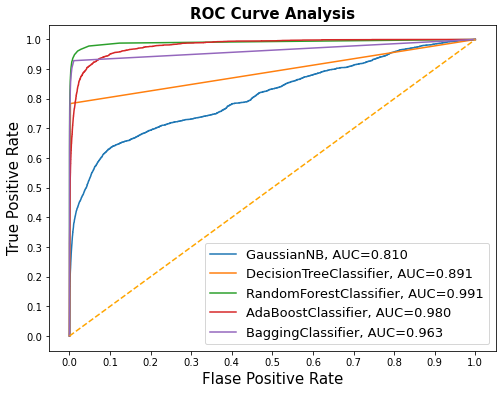

In [80]:
# Plotting ROC curve 

fig = plt.figure(figsize=(8,6))

for i in result_table.index:
    plt.plot(result_table.loc[i]['fpr'], 
             result_table.loc[i]['tpr'], 
             label="{}, AUC={:.3f}".format(i, result_table.loc[i]['auc']))
    
plt.plot([0,1], [0,1], color='orange', linestyle='--')

plt.xticks(np.arange(0.0, 1.1, step=0.1))
plt.xlabel("Flase Positive Rate", fontsize=15)

plt.yticks(np.arange(0.0, 1.1, step=0.1))
plt.ylabel("True Positive Rate", fontsize=15)

plt.title('ROC Curve Analysis', fontweight='bold', fontsize=15)
plt.legend(prop={'size':13}, loc='lower right')

plt.show()